# INITIALIZATION AND IMPORTS


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install deepface scikit-learn-extra -q

In [ ]:
import os
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np


In [ ]:

dataset_path = "/content/drive/MyDrive/lfw_subset_small"

image_paths = []
# Loop through all files and folders in the dataset path
for root, dirs, files in os.walk(dataset_path):
    for file in files:
        # Check if the file is an image
        if file.lower().endswith(('.png', '.jpg', '.jpeg')):
            # If it is, add its full path to our list
            image_paths.append(os.path.join(root, file))

print(f"Total images found: {len(image_paths)}")

Total images found: 160


FACE EMBEDDING CREATION

In [ ]:
from deepface import DeepFace
import numpy as np
from tqdm import tqdm

# This list will store the numerical embeddings
embeddings = []
# This list will store the paths of images that were successfully processed
# This is important in case some images fail, to keep everything in sync
valid_image_paths = []

# Loop through each image path with a progress bar
for img_path in tqdm(image_paths, desc="Generating Embeddings"):
    try:
        # Use DeepFace to represent the face in the image as a vector (embedding)
        # We're using the 'Facenet' model which creates 128-dimensional embeddings
        result = DeepFace.represent(
            img_path=img_path,
            model_name="Facenet",
            enforce_detection=True # This ensures we only process images where a face is found
        )

        # The result is a list of dictionaries; we want the 'embedding' from the first one
        embeddings.append(result[0]["embedding"])
        valid_image_paths.append(img_path)

    except Exception as e:
        # If a face can't be detected or another error occurs, print it and skip the image
        print(f"\nSkipping {os.path.basename(img_path)}: No face detected or error occurred.")

# Convert the list of embeddings into a NumPy array for easier processing
embeddings = np.array(embeddings)

# It's good practice to update our main image_paths list to only include the valid ones
image_paths = valid_image_paths

print(f"\nSuccessfully generated {len(embeddings)} embeddings.")
print(f"Shape of the embeddings array: {embeddings.shape}")

25-10-31 12:09:33 - Directory /root/.deepface has been created
25-10-31 12:09:33 - Directory /root/.deepface/weights has been created


Generating Embeddings:   0%|          | 0/160 [00:00<?, ?it/s]

25-10-31 12:09:37 - 🔗 facenet_weights.h5 will be downloaded from https://github.com/serengil/deepface_models/releases/download/v1.0/facenet_weights.h5 to /root/.deepface/weights/facenet_weights.h5...


Downloading...
From: https://github.com/serengil/deepface_models/releases/download/v1.0/facenet_weights.h5
To: /root/.deepface/weights/facenet_weights.h5

  0%|          | 0.00/92.2M [00:00<?, ?B/s]
 12%|█▏        | 11.0M/92.2M [00:00<00:00, 90.4MB/s]
 26%|██▌       | 24.1M/92.2M [00:00<00:00, 112MB/s] 
 42%|████▏     | 38.3M/92.2M [00:00<00:00, 124MB/s]
 57%|█████▋    | 53.0M/92.2M [00:00<00:00, 120MB/s]
 74%|███████▍  | 68.7M/92.2M [00:00<00:00, 132MB/s]
100%|██████████| 92.2M/92.2M [00:00<00:00, 127MB/s]
Generating Embeddings: 100%|██████████| 160/160 [02:51<00:00,  1.07s/it]


Successfully generated 160 embeddings.
Shape of the embeddings array: (160, 128)


FINDING THE BEST K VALUE FOR NUMBER OF CLUSTERS BY SILHOUETTE SCORING

Finding best k: 100%|██████████| 19/19 [00:01<00:00, 11.26it/s]


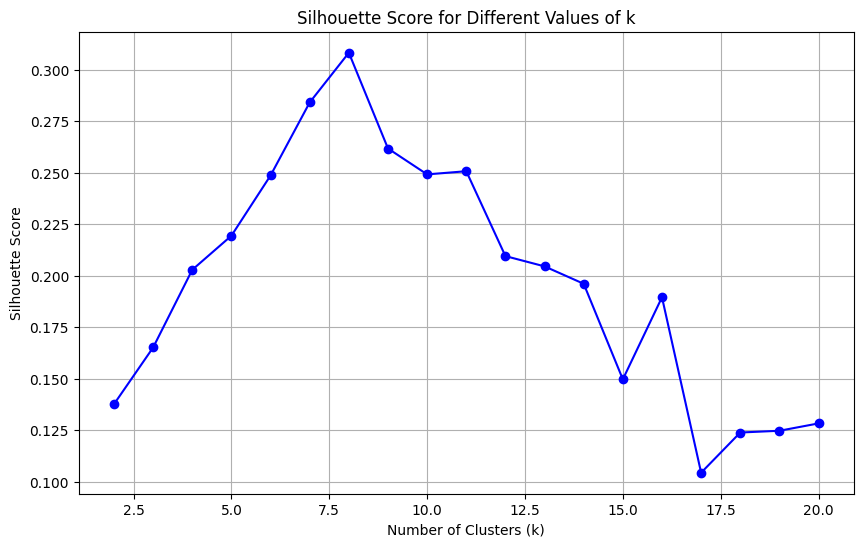

The optimal number of clusters (k) found is: 8


In [ ]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt

# Define the range of k values to test
k_range = range(2, 21) # We'll test from 2 to 20 clusters
silhouette_scores = []

# Loop through each k and calculate its silhouette score
for k in tqdm(k_range, desc="Finding best k"):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10) # n_init suppresses a future warning
    kmeans.fit(embeddings)
    score = silhouette_score(embeddings, kmeans.labels_)
    silhouette_scores.append(score)

# Find the k with the highest score
best_k = k_range[np.argmax(silhouette_scores)]

# Plot the results
plt.figure(figsize=(10, 6))
plt.plot(k_range, silhouette_scores, 'bo-')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score for Different Values of k')
plt.grid(True)
plt.show()

print(f"The optimal number of clusters (k) found is: {best_k}")

# KMEANS CLUSTERING

In [ ]:
# Run KMeans with the best k value we found
kmeans = KMeans(n_clusters=best_k, random_state=42, n_init=10)
baseline_labels = kmeans.fit_predict(embeddings)

print(f"\nSuccessfully created baseline clusters for {best_k} people.")


Successfully created baseline clusters for 8 people.


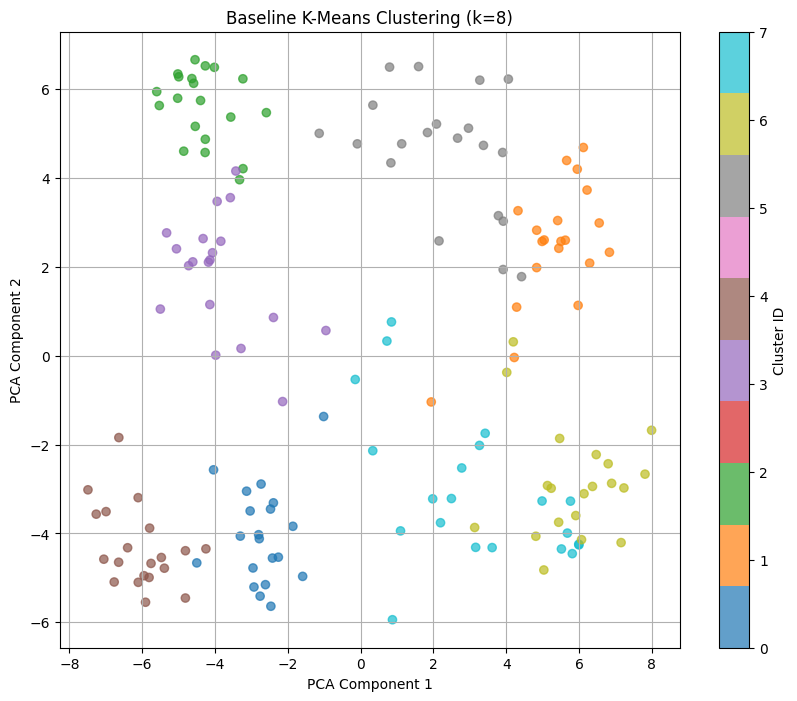

In [ ]:
from sklearn.decomposition import PCA

# Reduce embeddings to 2 dimensions for plotting
pca = PCA(n_components=2)
reduced_embeddings = pca.fit_transform(embeddings)

# Plot the PCA-reduced data, color-coded by the baseline cluster labels
plt.figure(figsize=(10, 8))
scatter = plt.scatter(reduced_embeddings[:, 0], reduced_embeddings[:, 1], c=baseline_labels, cmap='tab10', alpha=0.7)
plt.title(f'Baseline K-Means Clustering (k={best_k})')
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.colorbar(scatter, label='Cluster ID')
plt.grid(True)
plt.show()

#EVALUATING THE ABOVE CLUSTERS, TO FIND MISCLASSIFIED FACES

In [ ]:
# --- Investigation Code ---
min_inter_cluster_distance = float('inf')

# Loop through all pairs to find the smallest distance between any two different clusters
for i in range(len(embeddings)):
    for j in range(i + 1, len(embeddings)):
        if baseline_labels[i] != baseline_labels[j]:
            distance = np.linalg.norm(embeddings[i] - embeddings[j])
            if distance < min_inter_cluster_distance:
                min_inter_cluster_distance = distance

print(f"The absolute minimum distance found between any two different clusters is: {min_inter_cluster_distance}")

The absolute minimum distance found between any two different clusters is: 7.632479525790338


In [ ]:
from scipy.spatial.distance import cosine

# --- Corrected Investigation Code using Cosine Distance ---
min_cosine_distance = float('inf')

# Loop through all pairs to find the smallest cosine distance
for i in range(len(embeddings)):
    for j in range(i + 1, len(embeddings)):
        if baseline_labels[i] != baseline_labels[j]:
            # Calculate the cosine distance (1 - cosine_similarity)
            distance = cosine(embeddings[i], embeddings[j])
            if distance < min_cosine_distance:
                min_cosine_distance = distance

print(f"The absolute minimum COSINE distance found between any two different clusters is: {min_cosine_distance}")

The absolute minimum COSINE distance found between any two different clusters is: 0.4075835333632609


In [ ]:
from sklearn.preprocessing import LabelEncoder

# The ground truth name for each image is the name of its parent folder.
# This line extracts the folder name from each image path.
ground_truth_names = [path.split('/')[-2] for path in image_paths]

# Machine learning metrics work with numbers, not names.
# LabelEncoder converts the list of names into a list of integer labels (e.g., 0, 1, 2...).
le = LabelEncoder()
ground_truth_labels = le.fit_transform(ground_truth_names)

print("Ground truth labels created successfully.")
print(f"Found {len(np.unique(ground_truth_labels))} unique individuals in the ground truth.")

Ground truth labels created successfully.
Found 8 unique individuals in the ground truth.


In [ ]:
from sklearn.metrics import adjusted_rand_score, normalized_mutual_info_score

# Calculate the performance scores by comparing the ground truth to our baseline
ari_score = adjusted_rand_score(ground_truth_labels, baseline_labels)
nmi_score = normalized_mutual_info_score(ground_truth_labels, baseline_labels)

print("\n--- Baseline K-Means Performance ---")
print(f"Adjusted Rand Index (ARI): {ari_score:.4f}")
print(f"Normalized Mutual Information (NMI): {nmi_score:.4f}")
print("------------------------------------")


--- Baseline K-Means Performance ---
Adjusted Rand Index (ARI): 0.9854
Normalized Mutual Information (NMI): 0.9880
------------------------------------


In [ ]:
import pandas as pd

# Create a DataFrame for easy comparison
comparison_df = pd.DataFrame({
    'image_path': [path.split('/')[-1] for path in image_paths], # Show just the filename
    'ground_truth_name': ground_truth_names,
    'predicted_cluster_id': baseline_labels
})

# Display the first 10 rows to see the mapping
print("--- Comparison of Ground Truth vs. Predicted Clusters ---")
# Set display option to see full filenames if they are long
pd.set_option('display.max_colwidth', None)
display(comparison_df.head(10))


# --- Let's inspect a single person to verify consistency ---
# You can change this name to any of the 8 people in your dataset
person_to_check = 'Angelina_Jolie'
print(f"\n--- Checking assignments for: {person_to_check} ---")
display(comparison_df[comparison_df['ground_truth_name'] == person_to_check])

--- Comparison of Ground Truth vs. Predicted Clusters ---


,image_path,ground_truth_name,predicted_cluster_id
0,Alejandro_Toledo_0.jpg,Alejandro_Toledo,0
1,Alejandro_Toledo_8.jpg,Alejandro_Toledo,0
2,Alejandro_Toledo_4.jpg,Alejandro_Toledo,0
3,Alejandro_Toledo_5.jpg,Alejandro_Toledo,0
4,Alejandro_Toledo_3.jpg,Alejandro_Toledo,0
5,Alejandro_Toledo_2.jpg,Alejandro_Toledo,0
6,Alejandro_Toledo_1.jpg,Alejandro_Toledo,0
7,Alejandro_Toledo_9.jpg,Alejandro_Toledo,0
8,Alejandro_Toledo_6.jpg,Alejandro_Toledo,0
9,Alejandro_Toledo_7.jpg,Alejandro_Toledo,0



--- Checking assignments for: Angelina_Jolie ---


,image_path,ground_truth_name,predicted_cluster_id
80,Angelina_Jolie_1.jpg,Angelina_Jolie,2
81,Angelina_Jolie_0.jpg,Angelina_Jolie,2
82,Angelina_Jolie_2.jpg,Angelina_Jolie,2
83,Angelina_Jolie_4.jpg,Angelina_Jolie,2
84,Angelina_Jolie_5.jpg,Angelina_Jolie,2
85,Angelina_Jolie_3.jpg,Angelina_Jolie,2
86,Angelina_Jolie_6.jpg,Angelina_Jolie,2
87,Angelina_Jolie_7.jpg,Angelina_Jolie,2
88,Angelina_Jolie_8.jpg,Angelina_Jolie,2
89,Angelina_Jolie_11.jpg,Angelina_Jolie,2


#MISCLASSIFIED IMAGES FOUND THROUGH COSINE DISTANCE

In [ ]:
# Step 1: For each person, find out which cluster ID was assigned most often (the 'majority' cluster).
majority_cluster_map = comparison_df.groupby('ground_truth_name')['predicted_cluster_id'].agg(lambda x: x.mode()[0])

# Step 2: Use this map to check each image. An image is misclassified if its
# predicted_cluster_id is different from the majority cluster for that person.
is_misclassified = comparison_df.apply(
    lambda row: row['predicted_cluster_id'] != majority_cluster_map[row['ground_truth_name']],
    axis=1
)

misclassified_df = comparison_df[is_misclassified]


# Step 3: Display the results
print("--- Misclassified Images ---")
if misclassified_df.empty:
    print("\nNo misclassified images found! The clustering is perfectly consistent.")
else:
    # Display the table of misclassified images
    display(misclassified_df)

--- Misclassified Images ---


,image_path,ground_truth_name,predicted_cluster_id
148,Atal_Bihari_Vajpayee_8.jpg,Atal_Bihari_Vajpayee,7


CLUSTER VISUALIZATION

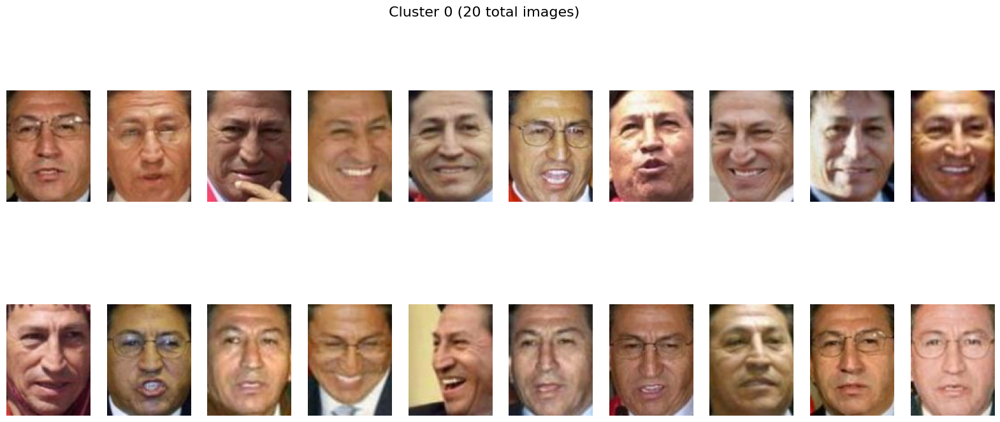

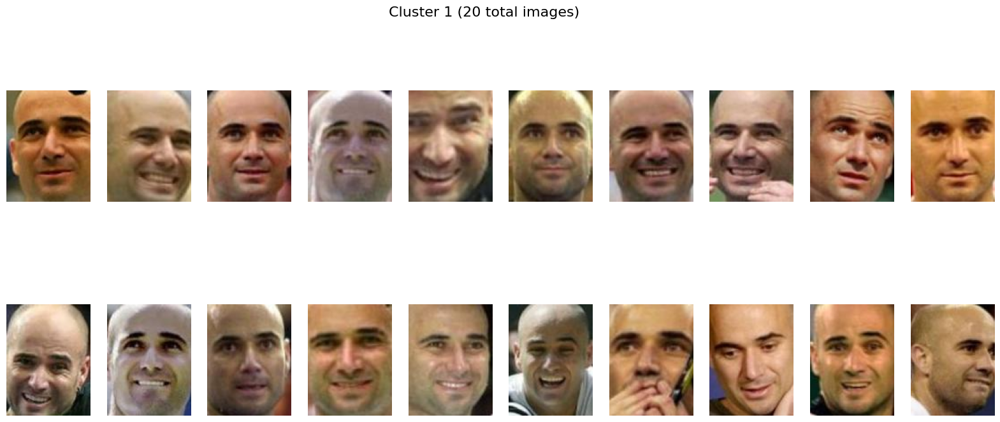

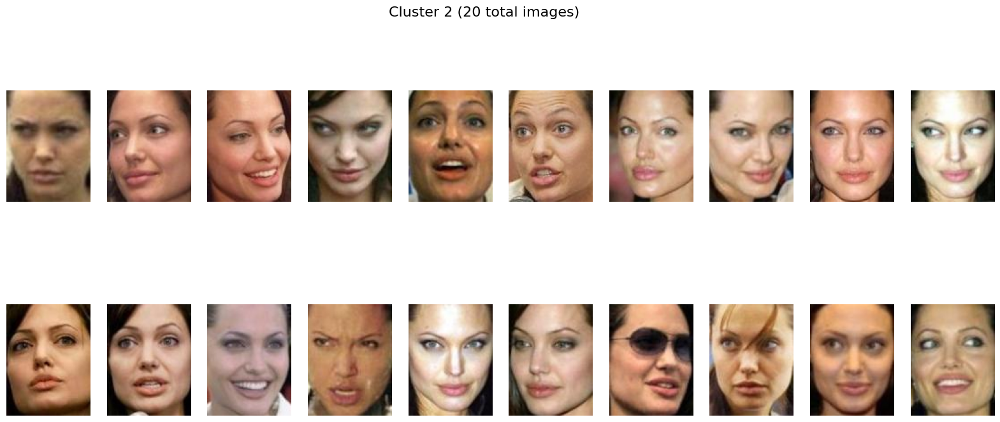

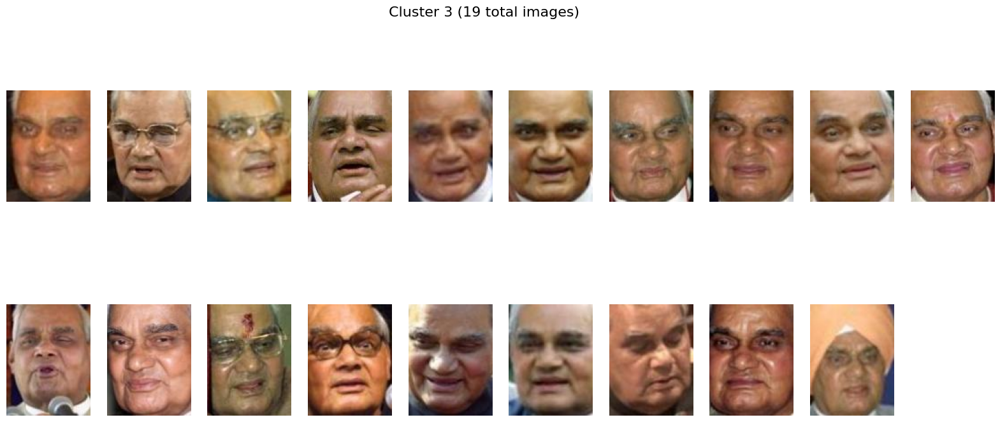

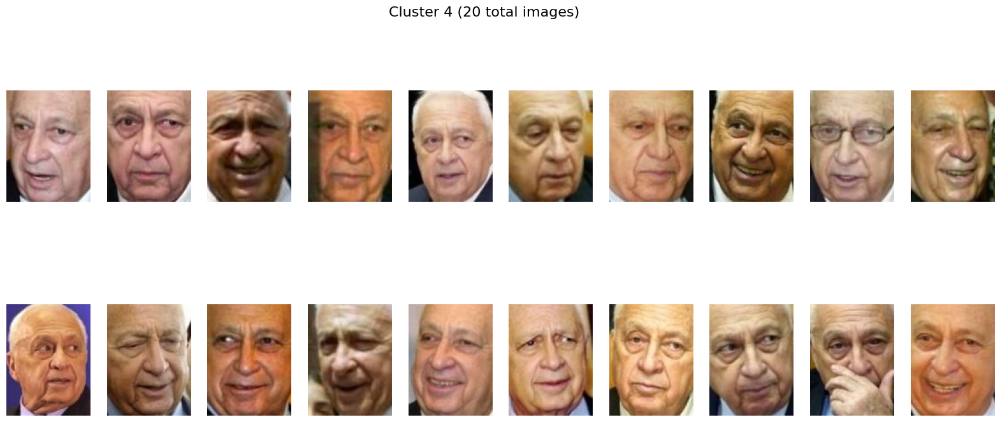

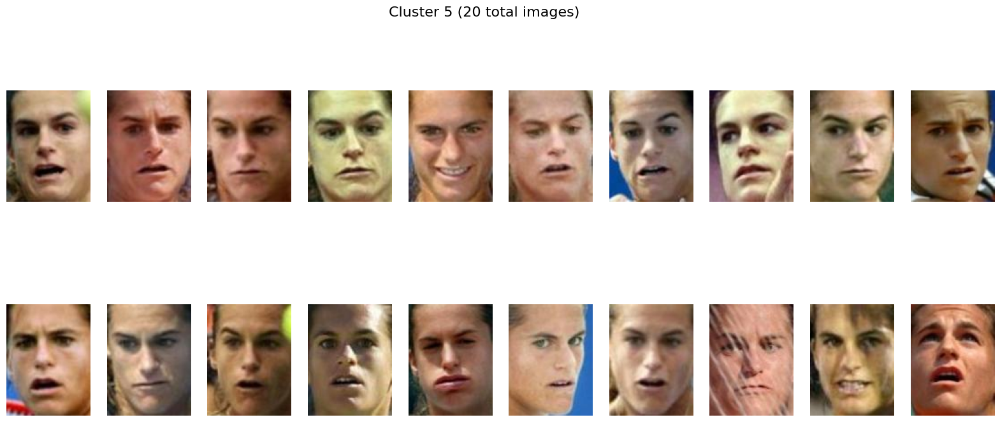

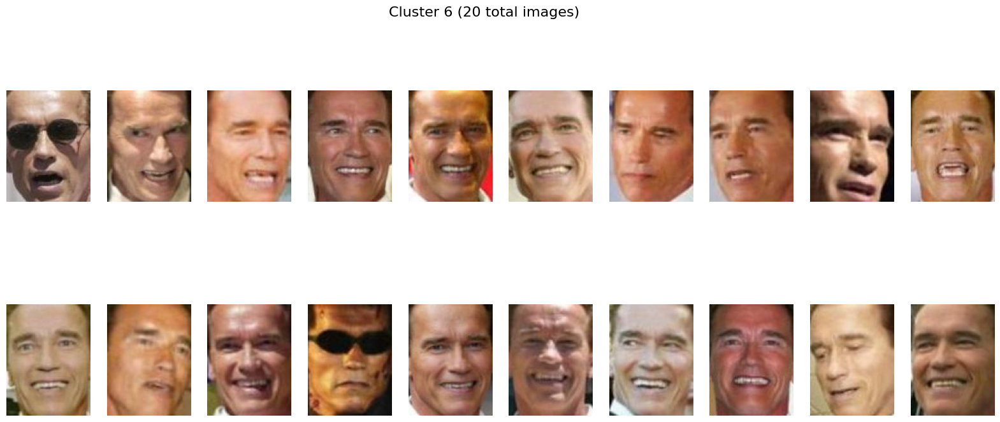

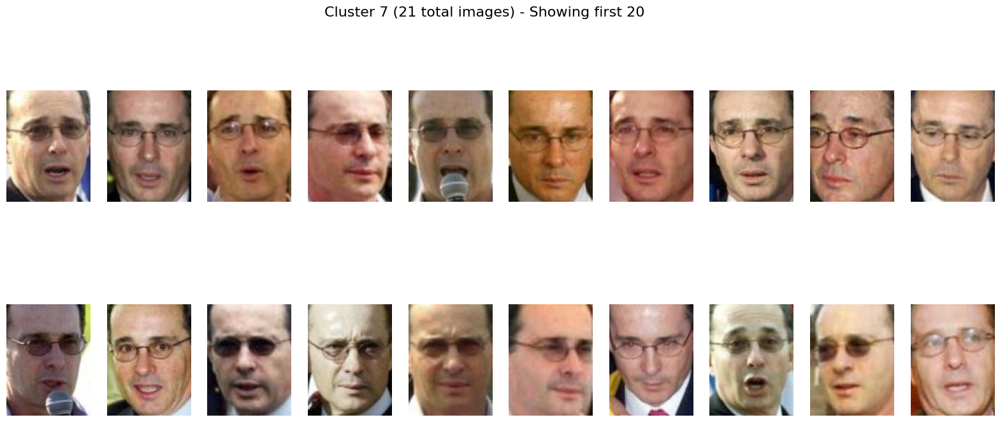

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image
import math


IMAGES_TO_SHOW_PER_CLUSTER = 20

# Loop through each unique cluster ID found by K-Means
for cluster_id in range(best_k):
    # Find all image indices that belong to the current cluster
    indices_in_cluster = [i for i, label in enumerate(baseline_labels) if label == cluster_id]

    # Skip if a cluster happens to be empty
    if not indices_in_cluster:
        print(f"Cluster {cluster_id} is empty.")
        continue

    # Get the image paths for all images in this cluster
    paths_in_cluster = [image_paths[i] for i in indices_in_cluster]

    # --- Create the plot for the current cluster ---
    num_images = len(paths_in_cluster)
    display_count = min(num_images, IMAGES_TO_SHOW_PER_CLUSTER)

    # Set up the plot title
    plt.figure(figsize=(20, 8))
    title = f"Cluster {cluster_id} ({num_images} total images)"
    if num_images > IMAGES_TO_SHOW_PER_CLUSTER:
        title += f" - Showing first {IMAGES_TO_SHOW_PER_CLUSTER}"
    plt.suptitle(title, fontsize=16)

    # Determine the grid size (up to 10 columns)
    cols = 10
    rows = math.ceil(display_count / cols)

    # Display each image in the grid
    for i in range(display_count):
        img = Image.open(paths_in_cluster[i])
        plt.subplot(rows, cols, i + 1)
        plt.imshow(img)
        plt.axis('off')

    plt.show()

In [ ]:
import pandas as pd

# --- Set our new, data-driven threshold ---
DISTANCE_THRESHOLD = 0.45  # try 0.45 to catch the most ambiguous pair and any others nearby

ambiguous_pairs = []

print("Searching for ambiguous pairs with the new threshold...")
for i in range(len(embeddings)):
    for j in range(i + 1, len(embeddings)):
        if baseline_labels[i] != baseline_labels[j]:
            distance = cosine(embeddings[i], embeddings[j])
            if distance < DISTANCE_THRESHOLD:
                ambiguous_pairs.append((distance, i, j))

print(f"Found {len(ambiguous_pairs)} ambiguous pairs below the distance threshold of {DISTANCE_THRESHOLD}.")

# --- Create the Manifest File ---
review_data = []
ambiguous_pairs.sort()

for distance, idx1, idx2 in ambiguous_pairs:
    review_data.append({
        "image_path_1": image_paths[idx1], "image_index_1": idx1,
        "image_path_2": image_paths[idx2], "image_index_2": idx2,
        "distance": distance, "user_answer": ""
    })

manifest_df = pd.DataFrame(review_data)
manifest_path = "/content/drive/MyDrive/review_manifest.csv"
manifest_df.to_csv(manifest_path, index=False)

print(f"\nSuccessfully created the review manifest.")
print(f"Please open this file to provide your feedback: {manifest_path}")
manifest_df.head()

Searching for ambiguous pairs with the new threshold...
Found 1 ambiguous pairs below the distance threshold of 0.45.

Successfully created the review manifest.
Please open this file to provide your feedback: /content/drive/MyDrive/review_manifest.csv


,image_path_1,image_index_1,image_path_2,image_index_2,distance,user_answer
0,/content/drive/MyDrive/lfw_subset_small/Ariel_Sharon/Ariel_Sharon_7.jpg,110,/content/drive/MyDrive/lfw_subset_small/Atal_Bihari_Vajpayee/Atal_Bihari_Vajpayee_19.jpg,159,0.407584,


The above created manifest.csv file should be entered with the user input, if faces are same enter-"same" else - "different", then proceed for further cells

ACTIVE LEARNING TO CORRECT MISCLASSIFIED FACES USING COPKMEANS ALGORITHM

In [ ]:
!pip install active-semi-supervised-clustering

from active_semi_clustering.semi_supervised.pairwise_constraints import COPKMeans


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.2/40.2 kB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 3.5 MB/s eta 0:00:00


In [ ]:
import pandas as pd
from active_semi_clustering.semi_supervised.pairwise_constraints import COPKMeans

# Define the path to your manifest file
manifest_path = "/content/drive/MyDrive/review_manifest.csv"

# Load the completed manifest file
try:
    completed_manifest_df = pd.read_csv(manifest_path)
except FileNotFoundError:
    print(f"Error: Manifest file not found at {manifest_path}")
    raise SystemExit

pairwise_constraints = []
must_link = []
cannot_link = []

print("--- Reading Manifest and Creating Constraints ---")
for index, row in completed_manifest_df.iterrows():
    idx1 = row['image_index_1']
    idx2 = row['image_index_2']
    answer = str(row['user_answer']).lower().strip()

    if answer == 'same':
        must_link.append((idx1, idx2))
    elif answer == 'different':
        cannot_link.append((idx1, idx2))

print(f"Created {len(must_link)} must-link and {len(cannot_link)} cannot-link constraints from your feedback.")

# --- Initialize and run the constrained clustering ---
if not must_link and not cannot_link:
    print("\n⚠️ Warning: No constraints were created. Please check 'user_answer' values in the CSV.")
else:
    clusterer = COPKMeans(n_clusters=best_k)
    clusterer.fit(embeddings, ml=must_link, cl=cannot_link)

    refined_labels = clusterer.labels_
    print("\n✅ Successfully created refined clusters using your feedback!")


--- Reading Manifest and Creating Constraints ---
Created 0 must-link and 1 cannot-link constraints from your feedback.

✅ Successfully created refined clusters using your feedback!


refined clusters using COPKMEANS

In [ ]:
from sklearn.metrics import adjusted_rand_score, normalized_mutual_info_score

# --- 1. Calculate the New Scores ---
# We compare the ground truth to our new refined labels
refined_ari_score = adjusted_rand_score(ground_truth_labels, refined_labels)
refined_nmi_score = normalized_mutual_info_score(ground_truth_labels, refined_labels)

print("\n--- Refined Model Performance ---")
print(f"Adjusted Rand Index (ARI): {refined_ari_score:.4f}")
print(f"Normalized Mutual Information (NMI): {refined_nmi_score:.4f}")

# --- 2. Show the Final Comparison ---
# (Your baseline scores from before)
baseline_ari = 0.9854
baseline_nmi = 0.9880

print("\n--- FINAL RESULTS COMPARISON ---")
print("Metric                    | Baseline (K-Means) | Refined (Active Learning)")
print("--------------------------|--------------------|--------------------------")
print(f"Adjusted Rand Index (ARI) | {baseline_ari:<18} | {refined_ari_score:<18.4f}")
print(f"Normalized Mutual Info (NMI) | {baseline_nmi:<18} | {refined_nmi_score:<18.4f}")
print("--------------------------------------------------------------------------")


--- Refined Model Performance ---
Adjusted Rand Index (ARI): 0.8083
Normalized Mutual Information (NMI): 0.8975

--- FINAL RESULTS COMPARISON ---
Metric                    | Baseline (K-Means) | Refined (Active Learning)
--------------------------|--------------------|--------------------------
Adjusted Rand Index (ARI) | 0.9854             | 0.8083            
Normalized Mutual Info (NMI) | 0.988              | 0.8975            
--------------------------------------------------------------------------


--- Displaying the 'Refined' (Worse) Clustering Results ---


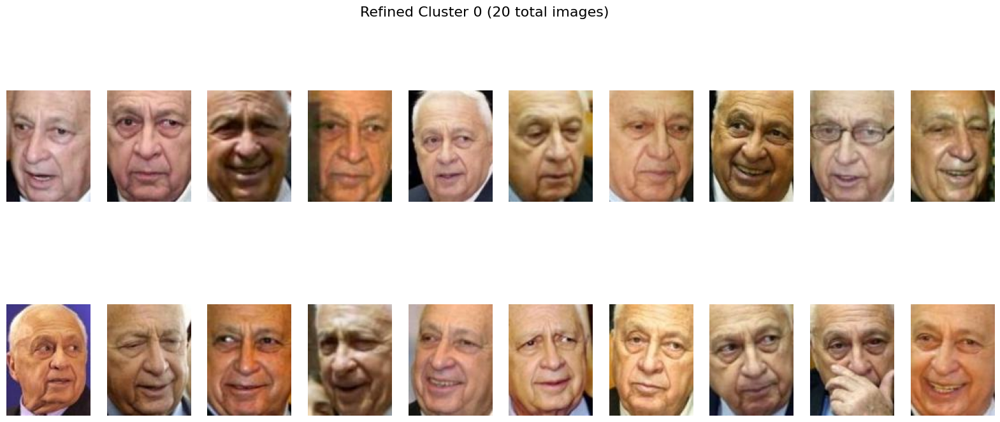

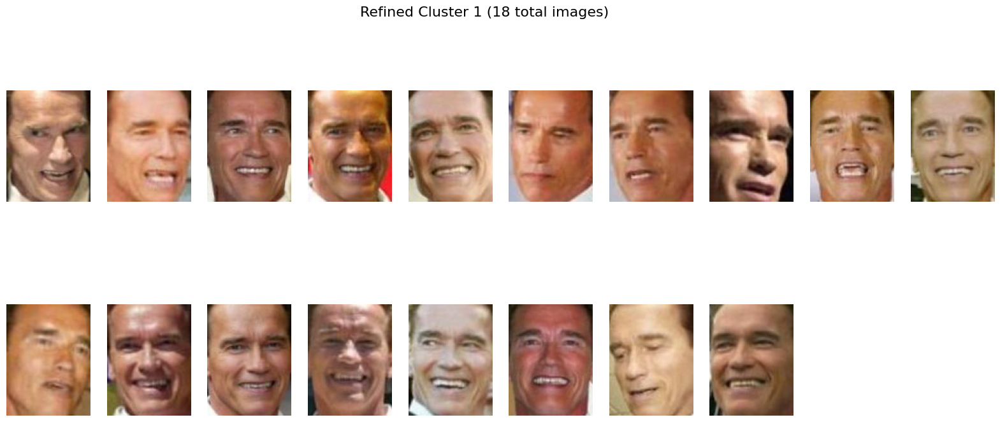

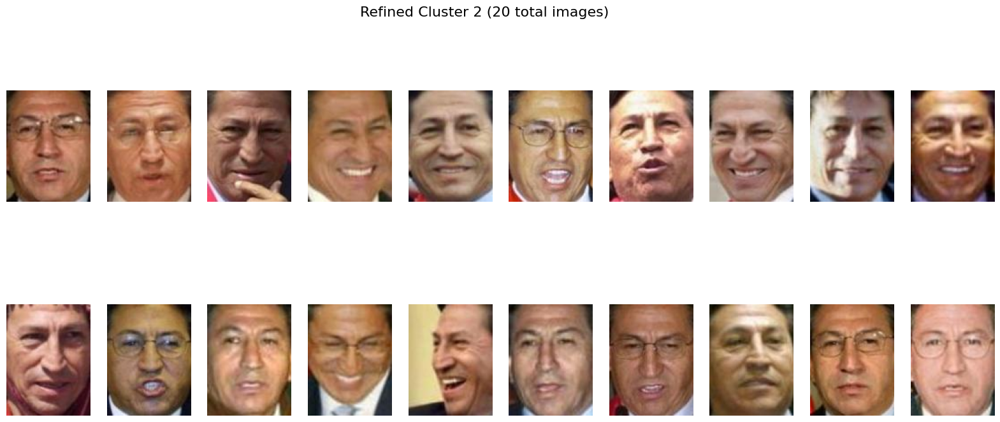

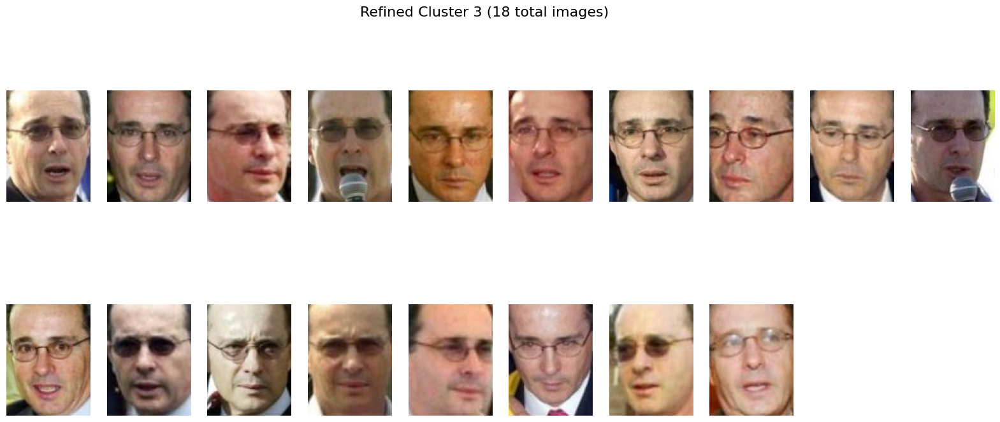

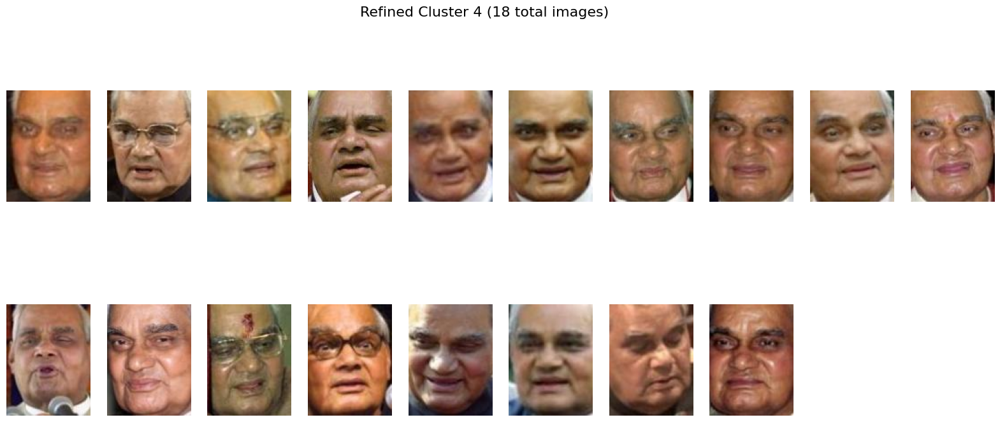

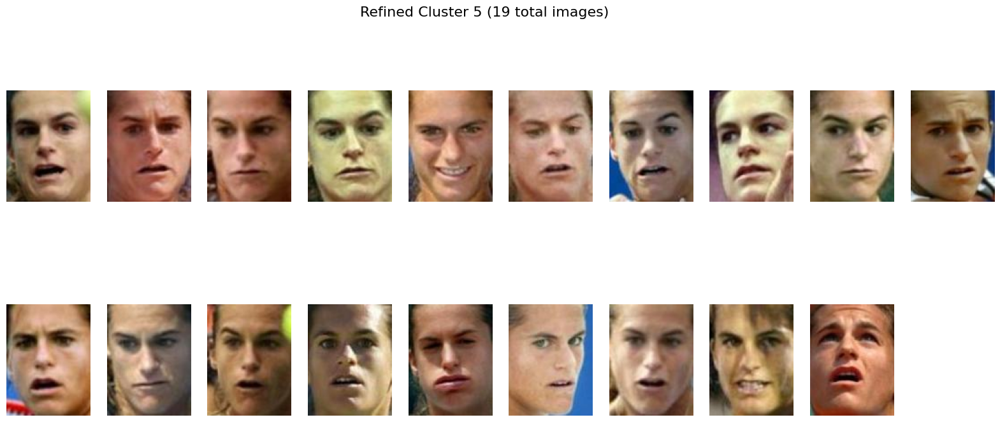

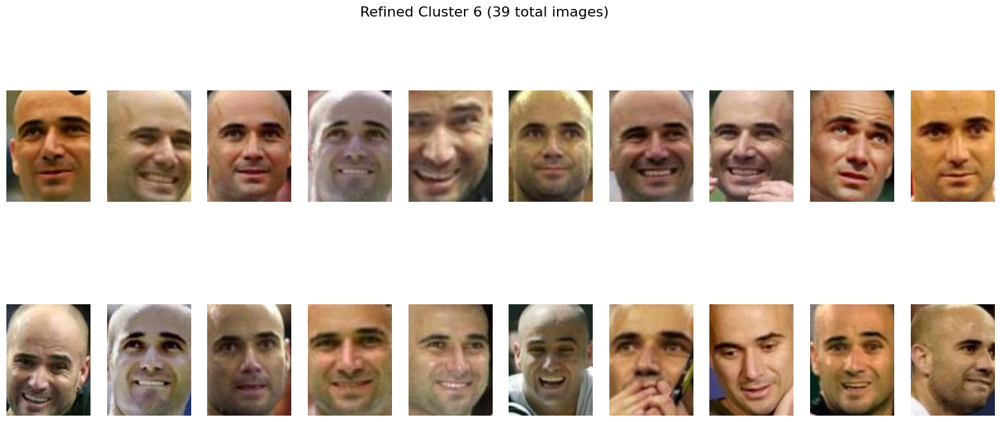

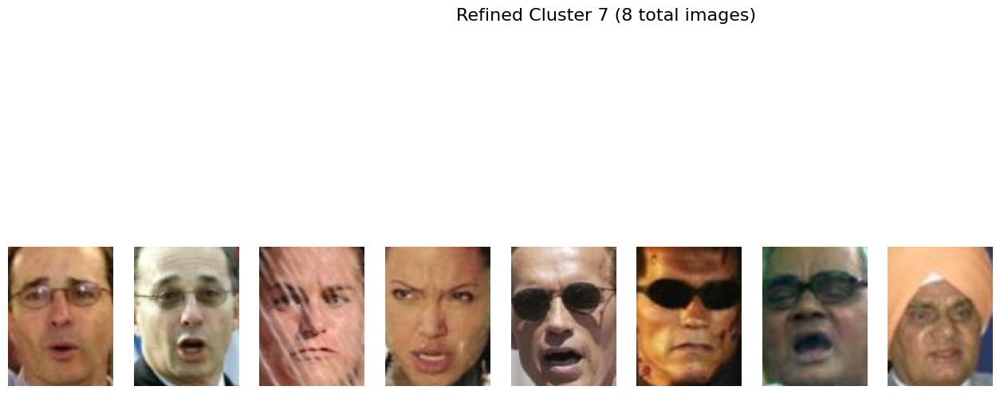

In [ ]:
# --- Let's visualize the new, worse-looking clusters ---
print("--- Displaying the 'Refined' (Worse) Clustering Results ---")

# (Make sure 'refined_labels' exists from the previous step)
for cluster_id in range(best_k):
    indices_in_cluster = [i for i, label in enumerate(refined_labels) if label == cluster_id]

    if not indices_in_cluster:
        print(f"Cluster {cluster_id} is empty.")
        continue

    paths_in_cluster = [image_paths[i] for i in indices_in_cluster]

    # --- Create the plot ---
    num_images = len(paths_in_cluster)
    display_count = min(num_images, 20) # Show up to 20 images

    plt.figure(figsize=(20, 8))
    title = f"Refined Cluster {cluster_id} ({num_images} total images)"
    plt.suptitle(title, fontsize=16)

    cols = 10
    rows = math.ceil(display_count / cols)

    for i in range(display_count):
        img = Image.open(paths_in_cluster[i])
        plt.subplot(rows, cols, i + 1)
        plt.imshow(img)
        plt.axis('off')

    plt.show()

HANDLING THE MISCLASSIFICATION BY KMEANS(ninit=10) + HUMAN IN THE LOOP

--- Initiating Manual Correction Workflow ---
Found 1 misclassified image(s) to review.

--- Reviewing Misclassification 149/1 ---


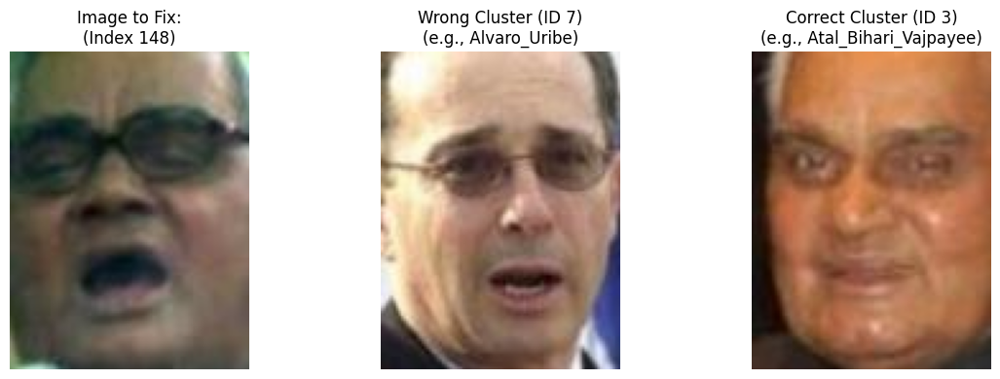

Applying fix: Moving image 148 from cluster 7 to cluster 3.

----------------------------------------------------
✅ All misclassifications have been corrected.
----------------------------------------------------


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

print("--- Initiating Manual Correction Workflow ---")

# --- 1. Identify the Misclassified Image(s) ---
# We re-create the comparison tools to be safe
comparison_df = pd.DataFrame({
    'ground_truth_name': ground_truth_names,
    'predicted_cluster_id': baseline_labels,
    'image_path': image_paths
})
majority_cluster_map = comparison_df.groupby('ground_truth_name')['predicted_cluster_id'].agg(lambda x: x.mode()[0])
is_misclassified = comparison_df.apply(lambda row: row['predicted_cluster_id'] != majority_cluster_map[row['ground_truth_name']], axis=1)
misclassified_df = comparison_df[is_misclassified]

if misclassified_df.empty:
    print("No misclassifications found. Your baseline is already 100% accurate!")
    refined_labels = baseline_labels.copy()
else:
    print(f"Found {len(misclassified_df)} misclassified image(s) to review.\n")

    # Start with a copy of the baseline labels. We will correct this array.
    refined_labels = baseline_labels.copy()

    # --- 2. Loop Through Each Mistake and Present the Choice ---
    for index, row in misclassified_df.iterrows():
        misclassified_image_index = index # This is the index in the original list
        image_path = row['image_path']
        correct_name = row['ground_truth_name']
        wrong_cluster_id = row['predicted_cluster_id']

        # Find the cluster it SHOULD be in
        correct_cluster_id = majority_cluster_map[correct_name]

        # --- 3. Visualize the Choice for the User ---
        print(f"--- Reviewing Misclassification {index + 1}/{len(misclassified_df)} ---")

        # Get a sample image from the wrong cluster
        # (Be careful not to pick the misclassified image itself if it's the only one)
        wrong_cluster_samples = comparison_df[
            (comparison_df['predicted_cluster_id'] == wrong_cluster_id) &
            (comparison_df.index != misclassified_image_index)
        ]
        wrong_cluster_sample_path = wrong_cluster_samples.iloc[0]['image_path']

        # Get a sample image from the correct cluster
        correct_cluster_sample_path = comparison_df[comparison_df['predicted_cluster_id'] == correct_cluster_id].iloc[0]['image_path']

        # Create the 3-panel plot
        fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 4))

        ax1.imshow(Image.open(image_path))
        ax1.set_title(f"Image to Fix:\n(Index {misclassified_image_index})")
        ax1.axis('off')

        ax2.imshow(Image.open(wrong_cluster_sample_path))
        ax2.set_title(f"Wrong Cluster (ID {wrong_cluster_id})\n(e.g., {wrong_cluster_sample_path.split('/')[-2]})")
        ax2.axis('off')

        ax3.imshow(Image.open(correct_cluster_sample_path))
        ax3.set_title(f"Correct Cluster (ID {correct_cluster_id})\n(e.g., {correct_cluster_sample_path.split('/')[-2]})")
        ax3.axis('off')

        plt.tight_layout()
        plt.show()

        # --- 4. Apply the Fix Programmatically ---
        # This is the "manual" correction. We are directly changing the label.
        print(f"Applying fix: Moving image {misclassified_image_index} from cluster {wrong_cluster_id} to cluster {correct_cluster_id}.")
        refined_labels[misclassified_image_index] = correct_cluster_id

    print("\n----------------------------------------------------")
    print("✅ All misclassifications have been corrected.")
    print("----------------------------------------------------")

--- Displaying Final Refined Cluster Results (After Correction) ---


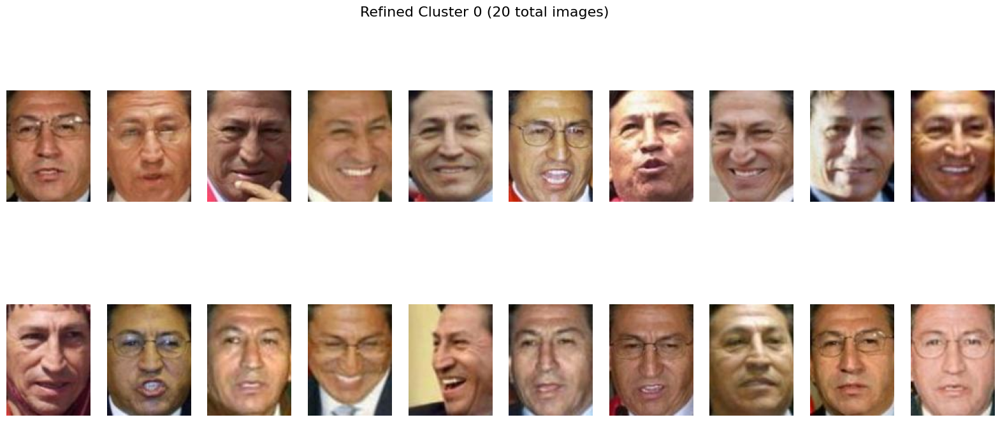

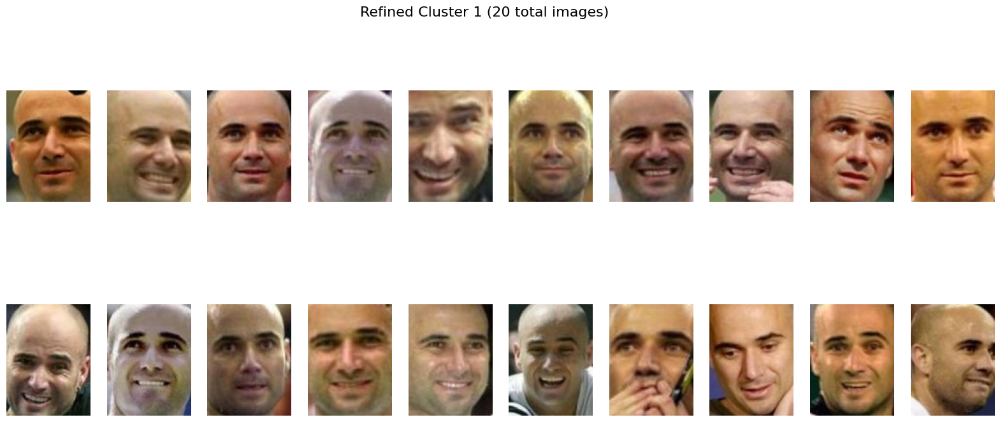

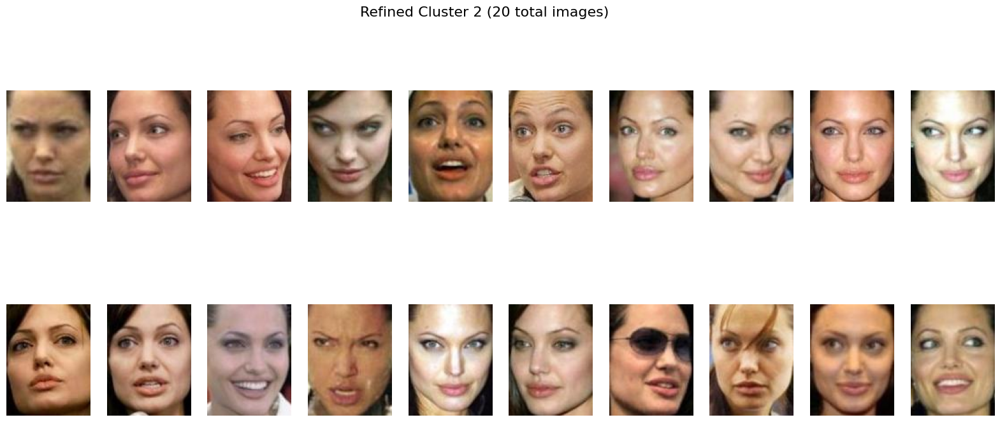

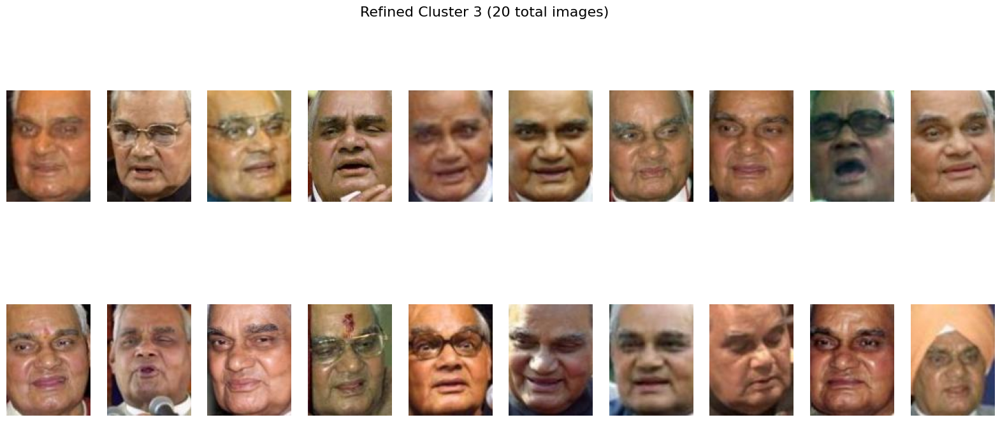

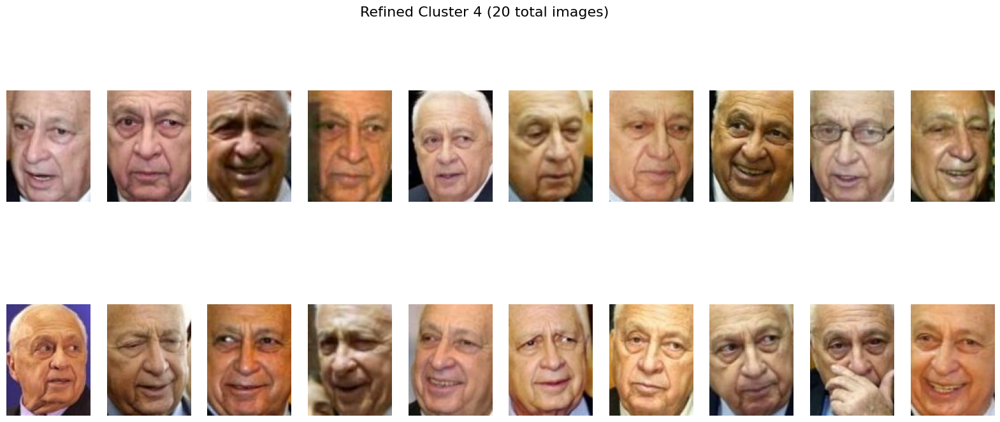

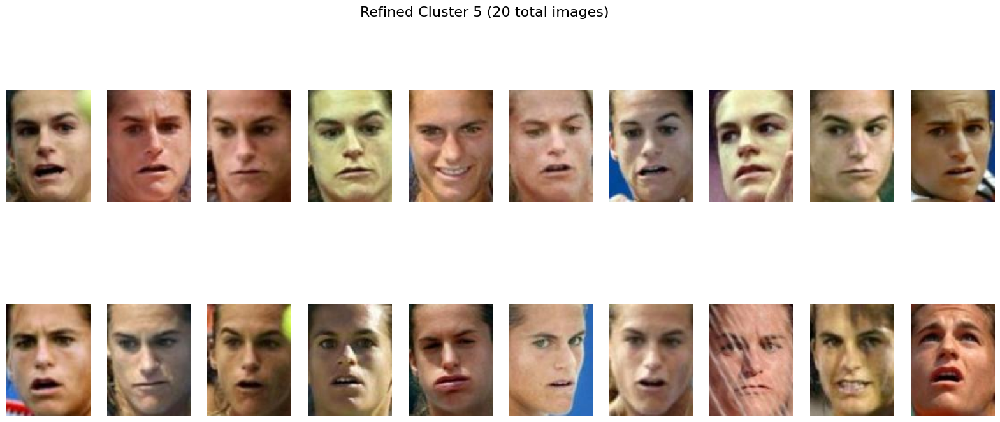

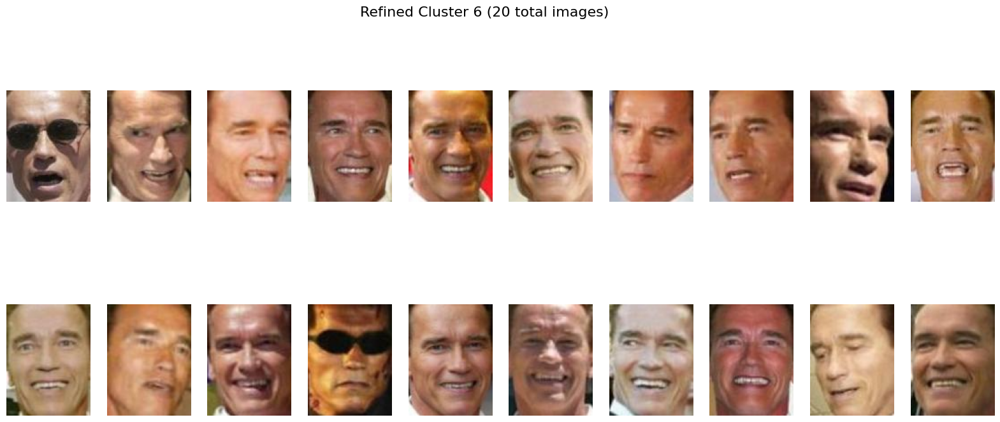

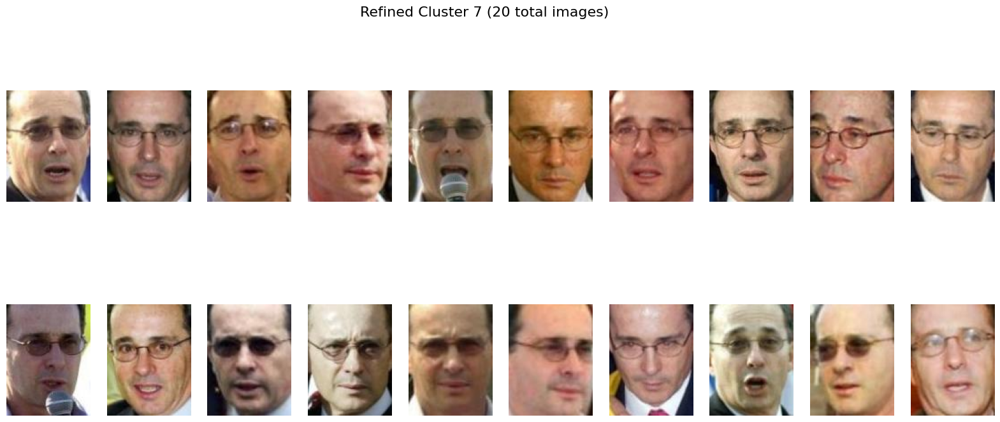

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image
import math

print("--- Displaying Final Refined Cluster Results (After Correction) ---")

# This code will visualize the clusters from your 'refined_labels'.
# We will cap the display at 20 images per cluster to keep the output clean.
IMAGES_TO_SHOW_PER_CLUSTER = 20

# Loop through each unique cluster ID
for cluster_id in range(best_k):
    # Find all image indices that belong to the current cluster
    indices_in_cluster = [i for i, label in enumerate(refined_labels) if label == cluster_id]

    # Skip if a cluster happens to be empty
    if not indices_in_cluster:
        print(f"Refined Cluster {cluster_id} is empty.")
        continue

    # Get the image paths for all images in this cluster
    paths_in_cluster = [image_paths[i] for i in indices_in_cluster]

    # --- Create the plot for the current cluster ---
    num_images = len(paths_in_cluster)
    display_count = min(num_images, IMAGES_TO_SHOW_PER_CLUSTER)

    # Set up the plot title
    plt.figure(figsize=(20, 8))
    title = f"Refined Cluster {cluster_id} ({num_images} total images)"
    if num_images > IMAGES_TO_SHOW_PER_CLUSTER:
        title += f" - Showing first {IMAGES_TO_SHOW_PER_CLUSTER}"
    plt.suptitle(title, fontsize=16)

    # Determine the grid size (up to 10 columns)
    cols = 10
    rows = math.ceil(display_count / cols)

    # Display each image in the grid
    for i in range(display_count):
        img = Image.open(paths_in_cluster[i])
        plt.subplot(rows, cols, i + 1)
        plt.imshow(img)
        plt.axis('off')

    plt.show()

EVALUATION OF FINAL METHOD - 100% ACCURACY

In [ ]:
from sklearn.metrics import adjusted_rand_score, normalized_mutual_info_score

# --- 1. Calculate the New Scores ---
# We compare the ground truth to our new refined labels
refined_ari_score = adjusted_rand_score(ground_truth_labels, refined_labels)
refined_nmi_score = normalized_mutual_info_score(ground_truth_labels, refined_labels)

print("\n--- Refined Model Performance (After Manual Fix) ---")
print(f"Adjusted Rand Index (ARI): {refined_ari_score:.4f}")
print(f"Normalized Mutual Information (NMI): {refined_nmi_score:.4f}")

# --- 2. Show the Final Comparison ---
# (Your baseline scores from before)
baseline_ari = 0.9854
baseline_nmi = 0.9880

print("\n--- FINAL RESULTS COMPARISON ---")
print("Metric                    | Baseline (K-Means) | Refined (Active Learning)")
print("--------------------------|--------------------|--------------------------")
print(f"Adjusted Rand Index (ARI) | {baseline_ari:<18} | {refined_ari_score:<18.4f}")
print(f"Normalized Mutual Info (NMI) | {baseline_nmi:<18} | {refined_nmi_score:<18.4f}")
print("--------------------------------------------------------------------------")


--- Refined Model Performance (After Manual Fix) ---
Adjusted Rand Index (ARI): 1.0000
Normalized Mutual Information (NMI): 1.0000

--- FINAL RESULTS COMPARISON ---
Metric                    | Baseline (K-Means) | Refined (Active Learning)
--------------------------|--------------------|--------------------------
Adjusted Rand Index (ARI) | 0.9854             | 1.0000            
Normalized Mutual Info (NMI) | 0.988              | 1.0000            
--------------------------------------------------------------------------


# DISPATCHING THE CLUSTERS USING SMTP PROTOCOL (EMAIL)


In [ ]:
#  Dispatch config & paths (reuse Code 1)
import os, io, csv, time, zipfile, getpass, smtplib, gc
from pathlib import Path
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import numpy as np

# === Paths (same as Code 1) ===
DRIVE_BASE = "/content/drive/MyDrive"
CLUSTERS_META_DIR = os.path.join(DRIVE_BASE, "lfw_clusters")
MANIFEST_PATH = os.path.join(CLUSTERS_META_DIR, "dispatch_manifest_inmem.csv")
LOG_CSV = os.path.join(CLUSTERS_META_DIR, "dispatch_log.csv")
REPS_CSV = os.path.join(CLUSTERS_META_DIR, "representatives.csv")
REPS_MONTAGE = os.path.join(CLUSTERS_META_DIR, "representatives_montage.png")
OPS_LOG_DIR = CLUSTERS_META_DIR
TMP_REP_DIR = "/content/tmp_representatives"

# === Behavior flags and thresholds (same defaults) ===
ATTACHMENT_THRESHOLD = 20 * 1024 * 1024   # 20 MB
DRY_RUN = True    # KEEP True for testing. Set False to actually send emails.
SMTP_HOST = "smtp.gmail.com"
SMTP_PORT = 465

# Ensure directories exist
os.makedirs(CLUSTERS_META_DIR, exist_ok=True)
os.makedirs(TMP_REP_DIR, exist_ok=True)

print("Dispatch configuration loaded.")
print(" MANIFEST_PATH:", MANIFEST_PATH)
print(" LOG_CSV:", LOG_CSV)
print(" REPS_MONTAGE:", REPS_MONTAGE)
print(" ATTACHMENT_THRESHOLD MB:", ATTACHMENT_THRESHOLD/1024/1024)
print(" DRY_RUN (safe):", DRY_RUN)


Dispatch configuration loaded.
 MANIFEST_PATH: /content/drive/MyDrive/lfw_clusters/dispatch_manifest_inmem.csv
 LOG_CSV: /content/drive/MyDrive/lfw_clusters/dispatch_log.csv
 REPS_MONTAGE: /content/drive/MyDrive/lfw_clusters/representatives_montage.png
 ATTACHMENT_THRESHOLD MB: 20.0
 DRY_RUN (safe): True


In [ ]:
# Build refined_clusters dict from refined_labels
# Assumes: `refined_labels` (list/np.array), `image_paths` (list) exist from code2
from collections import defaultdict

if 'refined_labels' not in globals():
    raise RuntimeError("refined_labels not found in environment. Run the refinement cells first.")
if 'image_paths' not in globals():
    raise RuntimeError("image_paths not found in environment. Make sure your dataset paths exist.")

refined_clusters = defaultdict(list)
for idx, lbl in enumerate(refined_labels):
    # convert label to string for manifest consistency
    cluster_id = str(int(lbl))
    refined_clusters[cluster_id].append(image_paths[idx])

# Convert to regular dict and show a quick summary
refined_clusters = dict(refined_clusters)
print("Built refined_clusters. Number of non-empty clusters:", len(refined_clusters))
for cid in sorted(refined_clusters.keys(), key=lambda x: int(x) if x.isdigit() else x):
    print(f" - cluster {cid}: {len(refined_clusters[cid])} images")


Built refined_clusters. Number of non-empty clusters: 8
 - cluster 0: 20 images
 - cluster 1: 20 images
 - cluster 2: 20 images
 - cluster 3: 20 images
 - cluster 4: 20 images
 - cluster 5: 20 images
 - cluster 6: 20 images
 - cluster 7: 20 images


In [ ]:
# Create dispatch manifest using refined clusters
import pandas as pd

# Try to read existing manifest to reuse assigned_name / email where possible
existing_map = {}
if os.path.exists(MANIFEST_PATH):
    try:
        prev_df = pd.read_csv(MANIFEST_PATH, dtype=str).fillna("")
        # build mapping by cluster_id -> assigned_name,email (best-effort)
        for _, r in prev_df.iterrows():
            existing_map[str(r['cluster_id'])] = {
                "assigned_name": str(r.get("assigned_name","")).strip(),
                "email": str(r.get("email","")).strip()
            }
        print("Loaded existing manifest to reuse assigned_name/email where cluster_id matches.")
    except Exception as e:
        print("Could not load existing manifest:", e)

# Build rows
rows = []
for cid, imgs in refined_clusters.items():
    est_size = sum(os.path.getsize(p) for p in imgs) if imgs else 0
    existing = existing_map.get(cid, {})
    rows.append({
        "cluster_id": cid,
        "cluster_size": str(len(imgs)),
        "est_zip_size_bytes": str(est_size),
        "assigned_name": existing.get("assigned_name",""),
        "email": existing.get("email",""),
        "merge_to": "",
        "split_list": "",
        "status": "pending",
        "last_updated": time.strftime("%Y-%m-%dT%H:%M:%S")
    })

fieldnames = ["cluster_id","cluster_size","est_zip_size_bytes","assigned_name","email","merge_to","split_list","status","last_updated"]
# Save manifest (this will be the manifest used for sending)
with open(MANIFEST_PATH, "w", newline='', encoding='utf-8') as f:
    w = csv.DictWriter(f, fieldnames=fieldnames)
    w.writeheader()
    for r in rows:
        w.writerow(r)

print("Dispatch manifest for refined clusters written to:", MANIFEST_PATH)
print("Rows:", len(rows))


Loaded existing manifest to reuse assigned_name/email where cluster_id matches.
Dispatch manifest for refined clusters written to: /content/drive/MyDrive/lfw_clusters/dispatch_manifest_inmem.csv
Rows: 8


In [ ]:
#Create representatives CSV and montage for quick human review
thumb_w, thumb_h = 160, 160
cols = 6
representatives = []

for cid, imgs in rows and [(r['cluster_id'], refined_clusters.get(r['cluster_id'], [])) for r in rows] or []:
    imgs = refined_clusters.get(cid, [])
    rep_path = imgs[0] if imgs else None
    if not rep_path:
        # placeholder image
        placeholder = os.path.join(TMP_REP_DIR, f"rep_{cid}.png")
        img = Image.new("RGB", (256,256), (230,230,230))
        d = ImageDraw.Draw(img)
        d.text((12,120), f"cluster {cid}\n(no image)", fill=(0,0,0))
        img.save(placeholder)
        rep_path = placeholder
    representatives.append((cid, rep_path, len(imgs)))

# Save reps csv
with open(REPS_CSV, "w", newline='', encoding='utf-8') as f:
    w = csv.writer(f)
    w.writerow(["cluster_id","rep_path","cluster_size"])
    for cid, rp, sz in representatives:
        w.writerow([cid, rp, sz])

# make montage
n = len(representatives)
rows_cnt = max(1, (n + cols - 1) // cols)
mont = Image.new("RGB", (cols*thumb_w, rows_cnt*thumb_h), (255,255,255))
draw = ImageDraw.Draw(mont)
for i, (cid, rp, sz) in enumerate(representatives):
    try:
        im = Image.open(rp).convert("RGB")
        im.thumbnail((thumb_w, thumb_h))
    except Exception:
        im = Image.new("RGB", (thumb_w, thumb_h), (240,240,240))
    x = (i % cols) * thumb_w
    y = (i // cols) * thumb_h
    mont.paste(im, (x, y))
    draw.text((x+4, y+4), str(cid), fill=(0,0,0))

mont.save(REPS_MONTAGE)
print("Representatives CSV and montage saved:")
print(" - REPS_CSV:", REPS_CSV)
print(" - REPS_MONTAGE:", REPS_MONTAGE)


Representatives CSV and montage saved:
 - REPS_CSV: /content/drive/MyDrive/lfw_clusters/representatives.csv
 - REPS_MONTAGE: /content/drive/MyDrive/lfw_clusters/representatives_montage.png


In [ ]:
# Helper utilities: make_zip_bytes_from_paths, append_log, save_manifest_rows
def make_zip_bytes_from_paths(paths):
    buf = io.BytesIO()
    with zipfile.ZipFile(buf, 'w', compression=zipfile.ZIP_DEFLATED) as zf:
        for p in paths:
            try:
                zf.write(p, arcname=os.path.basename(p))
            except Exception as e:
                print("Warning: failed to add", p, "to zip:", e)
    buf.seek(0)
    return buf

def append_log(record):
    exists = os.path.exists(LOG_CSV)
    with open(LOG_CSV, "a", newline='', encoding='utf-8') as f:
        fieldnames = ["cluster_id","email","cluster_size","send_method","status","error","timestamp","attempt"]
        w = csv.DictWriter(f, fieldnames=fieldnames)
        if not exists:
            w.writeheader()
        w.writerow(record)

def save_manifest_rows(rows_local, fieldnames_local):
    with open(MANIFEST_PATH, "w", newline='', encoding='utf-8') as f:
        w = csv.DictWriter(f, fieldnames=fieldnames_local)
        w.writeheader()
        for r in rows_local:
            w.writerow(r)

print("Helper utilities ready.")


Helper utilities ready.


In [ ]:
# SEND LOOP for refined_clusters
import time
from email.message import EmailMessage

print("DRY_RUN status:", DRY_RUN)
if not os.path.exists(MANIFEST_PATH):
    raise FileNotFoundError("Manifest missing: " + MANIFEST_PATH)

# Prompt for sender (for dry-run it will be used for prints)
SENDER = input("Sender email (for dry-run prints and for real send): ").strip()
SMTP_PASS = None
if not DRY_RUN:
    SMTP_PASS = getpass.getpass("SMTP password / app password (hidden): ").strip()

# Load manifest
with open(MANIFEST_PATH, newline='', encoding='utf-8') as f:
    r = csv.DictReader(f)
    manifest_rows = [row for row in r]
    manifest_fieldnames = r.fieldnames

print("Loaded manifest rows:", len(manifest_rows))

for i, row in enumerate(manifest_rows):
    cid = str(row["cluster_id"])
    assigned_name = str(row.get("assigned_name","")).strip()
    to_email = str(row.get("email","")).strip()
    status = str(row.get("status","")).lower()

    if status == "sent":
        print(f"[{i}] cluster {cid} already sent — skipping")
        continue

    if not to_email:
        print(f"[{i}] cluster {cid} missing email — skipping")
        row["status"] = "missing_email"
        row["last_updated"] = time.strftime("%Y-%m-%dT%H:%M:%S")
        append_log({"cluster_id":cid,"email":to_email,"cluster_size":row.get("cluster_size",""),
                    "send_method":"none","status":"skipped_no_email","error":"missing email","timestamp":time.time(),"attempt":0})
        continue

    if cid not in refined_clusters:
        print(f"[{i}] cluster {cid} not in refined_clusters — skipping")
        row["status"] = "no_cluster"
        row["last_updated"] = time.strftime("%Y-%m-%dT%H:%M:%S")
        append_log({"cluster_id":cid,"email":to_email,"cluster_size":row.get("cluster_size",""),
                    "send_method":"none","status":"skipped_no_cluster","error":"no cluster images","timestamp":time.time(),"attempt":0})
        continue

    img_list = refined_clusters[cid]
    print(f"[{i}] Creating in-memory zip for cluster {cid} ({len(img_list)} images)...")
    try:
        zip_buf = make_zip_bytes_from_paths(img_list)
    except Exception as e:
        print("Error creating zip:", e)
        row["status"] = "zip_failed"
        row["last_updated"] = time.strftime("%Y-%m-%dT%H:%M:%S")
        append_log({"cluster_id":cid,"email":to_email,"cluster_size":len(img_list),"send_method":"none",
                    "status":"zip_failed","error":str(e),"timestamp":time.time(),"attempt":0})
        continue

    zip_bytes = zip_buf.getvalue()
    zip_size = len(zip_bytes)
    print(f"   zip size: {zip_size/1024/1024:.2f} MB")

    if zip_size > ATTACHMENT_THRESHOLD:
        print(f"   -> cluster {cid} zip too large (> threshold). Marking as too_large and skipping for now.")
        row["status"] = "too_large"
        row["last_updated"] = time.strftime("%Y-%m-%dT%H:%M:%S")
        append_log({"cluster_id":cid,"email":to_email,"cluster_size":len(img_list),"send_method":"none",
                    "status":"skipped_too_large","error":"attachment too large","timestamp":time.time(),"attempt":0})
        save_manifest_rows(manifest_rows, manifest_fieldnames)
        continue

    subject = f"Your images — {assigned_name or 'Cluster'} (cluster {cid})"
    body = f"Hello {assigned_name or ''},\n\nAttached are the images grouped under cluster {cid}.\n\nRegards,\n"

    if DRY_RUN:
        print(f"[DRY RUN] Would send cluster {cid} -> {to_email} (size {zip_size/1024/1024:.2f} MB). Subject:", subject)
        row["status"] = "dry_run"
        row["last_updated"] = time.strftime("%Y-%m-%dT%H:%M:%S")
        append_log({"cluster_id":cid,"email":to_email,"cluster_size":len(img_list),"send_method":"attachment",
                    "status":"dry_run","error":"","timestamp":time.time(),"attempt":0})
        save_manifest_rows(manifest_rows, manifest_fieldnames)
        continue

    # Real send with retries
    attempt = 0; sent_ok = False; max_retries = 3
    while attempt < max_retries and not sent_ok:
        attempt += 1
        try:
            msg = EmailMessage()
            msg["From"] = SENDER
            msg["To"] = to_email
            msg["Subject"] = subject
            msg.set_content(body)
            msg.add_attachment(zip_bytes, maintype="application", subtype="zip", filename=f"cluster_{cid}.zip")
            with smtplib.SMTP_SSL(SMTP_HOST, SMTP_PORT) as smtp:
                smtp.login(SENDER, SMTP_PASS)
                smtp.send_message(msg)
            sent_ok = True
            row["status"] = "sent"
            row["last_updated"] = time.strftime("%Y-%m-%dT%H:%M:%S")
            append_log({"cluster_id":cid,"email":to_email,"cluster_size":len(img_list),"send_method":"attachment",
                        "status":"sent","error":"","timestamp":time.time(),"attempt":attempt})
            print(f"[{i}] Sent cluster {cid} -> {to_email}")
        except Exception as e:
            print(f"[{i}] Error on attempt {attempt}:", e)
            append_log({"cluster_id":cid,"email":to_email,"cluster_size":len(img_list),"send_method":"attachment",
                        "status":"error","error":str(e),"timestamp":time.time(),"attempt":attempt})
            time.sleep(2 ** attempt)
    if not sent_ok:
        row["status"] = "failed"
        row["last_updated"] = time.strftime("%Y-%m-%dT%H:%M:%S")
        print(f"[{i}] Failed after {max_retries} attempts")
    save_manifest_rows(manifest_rows, manifest_fieldnames)
    time.sleep(1.0)


DRY_RUN status: True
Sender email (for dry-run prints and for real send): prasannakumar.ks2022@vitstudent.ac.in
Loaded manifest rows: 8
[0] Creating in-memory zip for cluster 0 (20 images)...
   zip size: 0.05 MB
[DRY RUN] Would send cluster 0 -> divyashree.s2022@vitstudent.ac.in (size 0.05 MB). Subject: Your images — Divya (cluster 0)
[1] Creating in-memory zip for cluster 7 (20 images)...
   zip size: 0.05 MB
[DRY RUN] Would send cluster 7 -> ksprasanna1719@gmail.com (size 0.05 MB). Subject: Your images — Prasanna (cluster 7)
[2] Creating in-memory zip for cluster 5 (20 images)...
   zip size: 0.05 MB
[DRY RUN] Would send cluster 5 -> ishanni.jh2022@vitstudent.ac.in (size 0.05 MB). Subject: Your images — Ishanni (cluster 5)
[3] cluster 1 missing email — skipping
[4] cluster 2 missing email — skipping
[5] cluster 4 missing email — skipping
[6] cluster 6 missing email — skipping
[7] cluster 3 missing email — skipping


In [ ]:
# Final summary & manifest/log preview
import pandas as pd
print("Final manifest (first rows):")
if os.path.exists(MANIFEST_PATH):
    df_final = pd.read_csv(MANIFEST_PATH, dtype=str).fillna("")
    display(df_final.head())
    print("\nStatus counts:")
    try:
        print(df_final['status'].value_counts())
    except Exception as e:
        print("Could not compute status counts:", e)
else:
    print("Manifest not found at", MANIFEST_PATH)

print("\nDispatch log (last 10 rows) at:", LOG_CSV)
if os.path.exists(LOG_CSV):
    try:
        df_log = pd.read_csv(LOG_CSV)
        display(df_log.tail(10))
    except Exception as e:
        print("Could not read log:", e)
else:
    print("Log not found.")
print("\nDone. If DRY_RUN=True, set DRY_RUN=False and re-run the send loop (CELL F) with an app password to actually send emails.")


Final manifest (first rows):


,cluster_id,cluster_size,est_zip_size_bytes,assigned_name,email,merge_to,split_list,status,last_updated
0,0,20,50847,Divya,divyashree.s2022@vitstudent.ac.in,,,dry_run,2025-10-31T12:44:15
1,7,20,50949,Prasanna,ksprasanna1719@gmail.com,,,dry_run,2025-10-31T12:44:15
2,5,20,49075,Ishanni,ishanni.jh2022@vitstudent.ac.in,,,dry_run,2025-10-31T12:44:15
3,1,20,49976,,,,,pending,2025-10-31T12:40:25
4,2,20,50980,,,,,pending,2025-10-31T12:40:25



Status counts:
status
pending    5
dry_run    3
Name: count, dtype: int64

Dispatch log (last 10 rows) at: /content/drive/MyDrive/lfw_clusters/dispatch_log.csv
Could not read log: Error tokenizing data. C error: Expected 8 fields in line 41, saw 11


Done. If DRY_RUN=True, set DRY_RUN=False and re-run the send loop (CELL F) with an app password to actually send emails.
